# **Deep Learning** Final Project
## Task 2: ReIdentification
Here we train a model for the ReIdentification task. For training we will use a joint loss (triplet loss + person_id loss).


---


### Students:

*   **Zihadul Azam** [MAT. 221747]
*   **Ali Hamza** [MAT. 225088]
*   **Sabbavarapu Hanusha** [MAT. 225018]

### Import Libraries

In [1]:
import zipfile
import os
import random
from tqdm.notebook import tqdm

import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as tt
from torchvision.io import read_image
from torchvision.utils import make_grid
from torchsummary import summary
import torch.nn.functional as F

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn import preprocessing
from skimage import io, transform
from sklearn.metrics.pairwise import cosine_similarity

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

In [2]:
print(torch.__version__)

1.9.0+cu102


### Global Vars

In [3]:
batch_size = 32
epochs = 100

### Import input data

In [4]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


Set data folder path here

In [5]:
current_folder_path = '/content/drive/MyDrive/Colab Notebooks/DL'
input_folder_path = '/content/drive/MyDrive/Colab Notebooks/DL/data-folder'
dataset_folder_path = input_folder_path + '/dataset'

Unzip dataset folder

In [6]:
!unzip -q '/content/drive/MyDrive/Colab Notebooks/DL/data-folder/dataset'

In [7]:
!ls

annotations_train.csv  drive  queries  sample_data  test  train


### Device

In [8]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda:0')
    else:
        return torch.device('cpu')

In [9]:
device = get_default_device()
device

device(type='cuda', index=0)

## Statistics of training samples
We observe statistical properties of the training samples to determine the ideal number of images to retrieve for each query image.

In [10]:
# list of image file names
train_imgs = os.listdir('train')

train_imgs[:10]

['1304_c6_070585431.jpg',
 '1481_c5_024242228.jpg',
 '1062_c3_089462591.jpg',
 '1199_c5_061013173.jpg',
 '1481_c6_089229603.jpg',
 '1095_c5_033040791.jpg',
 '0164_c1_012602602.jpg',
 '1084_c2_026064203.jpg',
 '1411_c6_050520872.jpg',
 '0088_c3_030652467.jpg']

In [11]:
# get the image id from it's file name
train_imgs_data = []
for s in train_imgs:
  train_imgs_data.append([int(s.split('_')[0]), s])

train_imgs_df = pd.DataFrame(train_imgs_data, columns=['id', 'filename'])

train_imgs_df.head()

,id,filename
0,1304,1304_c6_070585431.jpg
1,1481,1481_c5_024242228.jpg
2,1062,1062_c3_089462591.jpg
3,1199,1199_c5_061013173.jpg
4,1481,1481_c6_089229603.jpg


Now groupby id and count the number of images per person

In [12]:
img_per_person = train_imgs_df.groupby('id')['filename'].count()
img_per_person

id
2        7
5       26
6       29
7       25
9       21
        ..
1493    27
1494    22
1497    22
1498    13
1501    17
Name: filename, Length: 751, dtype: int64

Plot statistics

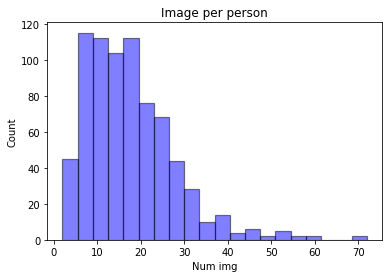

In [13]:
plt.hist(img_per_person.values, facecolor='blue', bins=20, alpha=0.5, edgecolor='black', linewidth=1.2)
plt.title("Image per person")
plt.ylabel("Count")
plt.xlabel("Num img")
plt.show()

In [14]:
print('Mean img of a person: ', img_per_person.mean())
print('Max img of a person: ', img_per_person.max())

Mean img of a person:  17.29560585885486
Max img of a person:  72


We can see here that maximum number of image per person is 72, while mean number of image per person is 17.2

In our opinion, retrieving **100 images** per query image could be a good number.

In [15]:
num_img_per_query = 100

## Data Loader

In [16]:
ann_csv_path = 'annotations_train.csv'
annotations_train_csv = pd.read_csv(ann_csv_path)

annotations_train_csv.head()

,id,age,backpack,bag,handbag,clothes,down,up,hair,hat,gender,upblack,upwhite,upred,uppurple,upyellow,upgray,upblue,upgreen,downblack,downwhite,downpink,downpurple,downyellow,downgray,downblue,downgreen,downbrown
0,474,2,1,1,1,1,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1
1,857,2,1,2,1,2,2,2,2,1,2,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2
2,1487,2,2,1,1,2,2,2,1,1,1,2,1,1,1,1,1,1,1,1,1,1,1,1,1,2,1,1
3,1422,2,1,2,1,2,2,2,1,1,1,1,2,1,1,1,1,1,1,2,1,1,1,1,1,1,1,1
4,856,2,2,1,1,2,2,2,2,1,2,1,2,1,1,1,1,1,1,2,1,1,1,1,1,1,1,1


In [17]:
# imgs from the train folder
train_imgs = os.listdir('train')
# get the image id from it's file name
train_imgs_data = []
for s in train_imgs:
  train_imgs_data.append([int(s.split('_')[0]), s])

train_imgs_df = pd.DataFrame(train_imgs_data, columns=['id', 'filename'])

train_imgs_df.head()

,id,filename
0,1304,1304_c6_070585431.jpg
1,1481,1481_c5_024242228.jpg
2,1062,1062_c3_089462591.jpg
3,1199,1199_c5_061013173.jpg
4,1481,1481_c6_089229603.jpg


In [18]:
annotations_train = pd.merge(annotations_train_csv, train_imgs_df, on='id')

# now we have filename column (last one) also inside the annotations dataframe
annotations_train

,id,age,backpack,bag,handbag,clothes,down,up,hair,hat,gender,upblack,upwhite,upred,uppurple,upyellow,upgray,upblue,upgreen,downblack,downwhite,downpink,downpurple,downyellow,downgray,downblue,downgreen,downbrown,filename
0,474,2,1,1,1,1,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,0474_c5_013563167.jpg
1,474,2,1,1,1,1,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,0474_c5_087766632.jpg
2,474,2,1,1,1,1,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,0474_c5_046017229.jpg
3,474,2,1,1,1,1,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,0474_c1_098614695.jpg
4,474,2,1,1,1,1,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,0474_c2_007717494.jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12984,1177,2,2,1,1,2,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,1177_c2_028331321.jpg
12985,1177,2,2,1,1,2,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,1177_c6_001668358.jpg
12986,1177,2,2,1,1,2,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,1177_c2_053033722.jpg
12987,1177,2,2,1,1,2,2,2,2,1,2,1,2,1,1,1,1,1,1,1,2,1,1,1,1,1,1,1,1177_c3_037640775.jpg


In [19]:
reid_train_annotations = annotations_train[['id', 'filename']]

### **Split data for Training and Validation**

We will split train data into:

*   validation data: `last 100 unique identities`
*   training data: `the rest`

We use `651 identities` in training set for training and the other `100 identities` are used as the validation set.

In [20]:
# get unique ids
unique_ids = reid_train_annotations.id.unique() 
# now we split ids into training and valid set
# last 100 is our validation data set
# the rest is for trining
valid_ids = unique_ids[-100:]
train_ids = unique_ids[:-100]

In [21]:
print('Trining identities len: ', len(train_ids))
print('Validation identities len: ', len(valid_ids))

Trining identities len:  651
Validation identities len:  100


Now split annotations into traning and validation, then save annotations as two separated csv files.

In [22]:
# get valid mask
valid_mask = reid_train_annotations['id'].isin(valid_ids)

In [23]:
# train dataframe (annotations)
train_df = reid_train_annotations.loc[~valid_mask]
train_df

,id,filename
0,474,0474_c5_013563167.jpg
1,474,0474_c5_087766632.jpg
2,474,0474_c5_046017229.jpg
3,474,0474_c1_098614695.jpg
4,474,0474_c2_007717494.jpg
...,...,...
11590,473,0473_c6_057027515.jpg
11591,473,0473_c6_076139706.jpg
11592,473,0473_c3_065315908.jpg
11593,473,0473_c5_010339677.jpg


In [24]:
# valid dataframe (annotations)
valid_df = reid_train_annotations.loc[valid_mask]
valid_df

,id,filename
11595,565,0565_c4_016746442.jpg
11596,565,0565_c5_058384193.jpg
11597,565,0565_c4_082478734.jpg
11598,565,0565_c1_032090754.jpg
11599,565,0565_c5_070138317.jpg
...,...,...
12984,1177,1177_c2_028331321.jpg
12985,1177,1177_c6_001668358.jpg
12986,1177,1177_c2_053033722.jpg
12987,1177,1177_c3_037640775.jpg


In [25]:
# save them as csv
pd.DataFrame(train_df, columns=['id', 'filename']).to_csv('reid_train_annotations.csv', index=False)
pd.DataFrame(valid_df, columns=['id', 'filename']).to_csv('reid_val_annotations.csv', index=False)

### Custom Dataset

In [26]:
class ReIdMarketDataset(Dataset):
  """ Market ReID dataset """

  def __init__(self, csv_file, root_dir, transform=None, has_id_info = False):
    """
    Args:
        csv_file (string): Path to the csv file with annotations.
        root_dir (string): Directory with all the images.
        transform (callable, optional): Optional transform to be applied
            on a sample.
    """
    self.annotations_frame = pd.read_csv(csv_file)
    self.root_dir = root_dir
    self.transform = transform
    self.has_id_info = has_id_info

  def __len__(self):
      return len(self.annotations_frame)

  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()

    anchor_img_path = os.path.join(self.root_dir, str(self.annotations_frame.iloc[idx, -1]))
    anchor_img = io.imread(anchor_img_path)
    anchor_img_id = int(self.annotations_frame.iloc[idx, 0])
    anchor_img_filename = str(self.annotations_frame.iloc[idx, -1])

    pos_img_candidates = self.annotations_frame[self.annotations_frame['id']==anchor_img_id].index
    pos_img_idx = random.choice(pos_img_candidates)
    pos_img_path = os.path.join(self.root_dir, str(self.annotations_frame.iloc[pos_img_idx, -1]))
    pos_img = io.imread(pos_img_path)
    pos_img_id = int(self.annotations_frame.iloc[pos_img_idx, 0])
    pos_img_filename = str(self.annotations_frame.iloc[pos_img_idx, -1])

    neg_img_candidates = self.annotations_frame[self.annotations_frame['id']!=anchor_img_id].index
    neg_img_idx = random.choice(neg_img_candidates)
    neg_img_path = os.path.join(self.root_dir, str(self.annotations_frame.iloc[neg_img_idx, -1]))
    neg_img = io.imread(neg_img_path)
    neg_img_id = int(self.annotations_frame.iloc[neg_img_idx, 0])
    neg_img_filename = str(self.annotations_frame.iloc[neg_img_idx, -1])

    sample = {
        'anchor_image': anchor_img,
        'anchor_image_id': anchor_img_id,
        'anchor_image_id_zero': anchor_img_id - 1, # ids in data set start from 1 and finish to 1501, but we want to start from 0
        'anchor_image_path': anchor_img_path,
        'anchor_image_filename': anchor_img_filename,
        'positive_image': pos_img,
        'positive_image_id': pos_img_id,
        'positive_image_id_zero': pos_img_id - 1, # ids in data set start from 1 and finish to 1501, but we want to start from 0
        'positive_image_path': pos_img_path,
        'positive_image_filename': pos_img_filename,
        'negative_image': neg_img,
        'negative_image_id': neg_img_id,
        'negative_image_id_zero': neg_img_id - 1, # ids in data set start from 1 and finish to 1501, but we want to start from 0
        'negative_image_path': neg_img_path,
        'negative_image_filename': neg_img_filename
    }

    if self.transform:
        sample['anchor_image'] = self.transform(sample['anchor_image'])
        sample['positive_image'] = self.transform(sample['positive_image'])
        sample['negative_image'] = self.transform(sample['negative_image'])

    return sample

In [27]:
tr_dataset = ReIdMarketDataset('reid_train_annotations.csv', 'train/')
val_dataset = ReIdMarketDataset('reid_val_annotations.csv', 'train/')

print('Train dataset len: ', len(tr_dataset))
print('Valid dataset len: ', len(val_dataset))

Train dataset len:  11595
Valid dataset len:  1394


### Data augmentation
Channel-wise normalization + Data augmentations

In [28]:
imagenet_stats = ([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])

train_tfms = tt.Compose([
    tt.ToPILImage(),
    tt.RandomCrop((128, 64), padding=8, padding_mode='reflect'),
#     tt.RandomResizedCrop(256, scale=(0.5,0.9), ratio=(1, 1)), 
#     tt.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1),
    tt.RandomHorizontalFlip(p=0.5), 
    tt.RandomRotation(10),
    tt.ToTensor(), 
    tt.Normalize(*imagenet_stats,inplace=True), 
    tt.RandomErasing(p=0.5, inplace=True)
])

valid_tfms = tt.Compose([
    tt.ToTensor(), 
    tt.Normalize(*imagenet_stats)
])

### Data loader

In [29]:
def get_data_loaders(train_csv, val_csv, batch_size=100):
  train_ds = ReIdMarketDataset(train_csv, 'train/', transform=train_tfms)
  val_ds = ReIdMarketDataset(val_csv, 'train/', transform=valid_tfms)

  train_dloader = torch.utils.data.DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)
  valid_dloader = torch.utils.data.DataLoader(val_ds, batch_size, num_workers=2, pin_memory=True)

  return train_dloader, valid_dloader

In [30]:
train_dloader, valid_dloader = get_data_loaders('reid_train_annotations.csv', 'reid_val_annotations.csv', batch_size=batch_size)

In [31]:
def show_batch(dl):
  for data in dl:
    fig, ax = plt.subplots(figsize=(32, 16))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(data['anchor_image'][:32], nrow=8).squeeze().permute(1, 2, 0).clamp(0,1))
    break

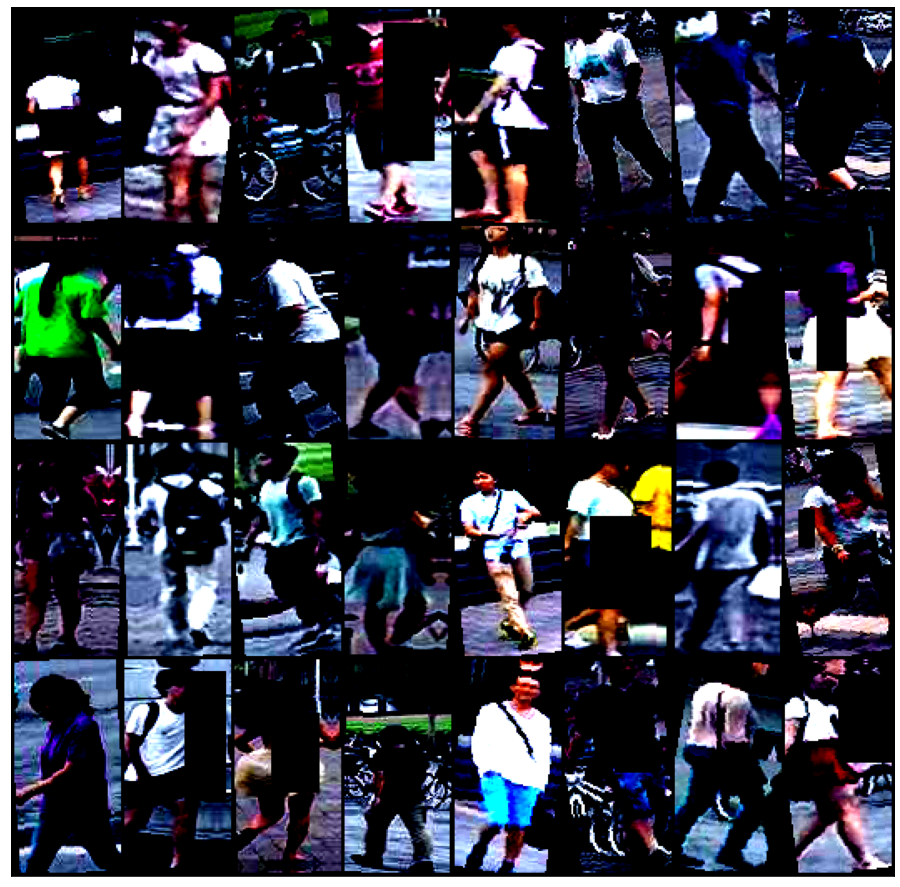

In [32]:
show_batch(train_dloader)

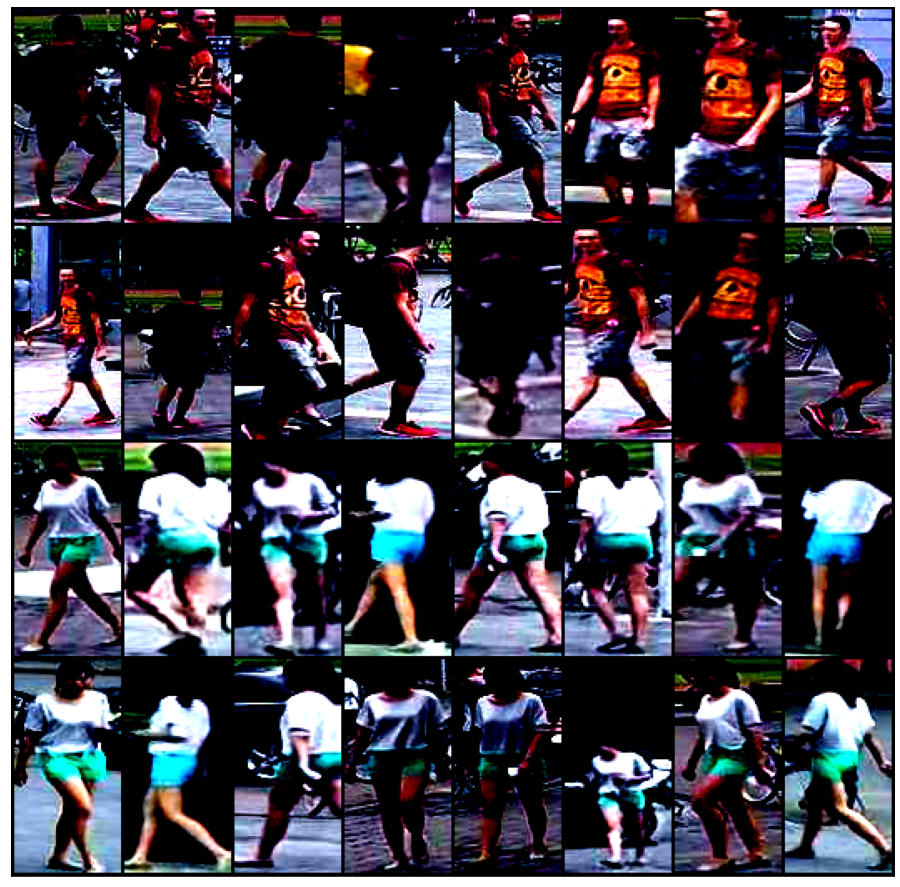

In [33]:
show_batch(valid_dloader)

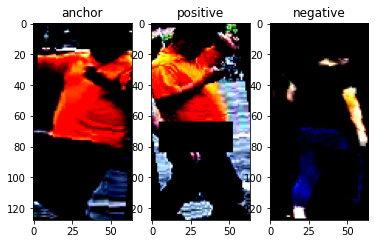

In [34]:
temp = next(iter(train_dloader))
anc = temp["anchor_image"][0].squeeze().permute(1, 2, 0).clamp(0,1)
pos = temp["positive_image"][0].squeeze().permute(1,2,0).clamp(0,1)
neg = temp["negative_image"][0].squeeze().permute(1,2,0).clamp(0,1)
# show plot
fig, axs = plt.subplots(1,3)
axs[0].imshow(anc)
axs[0].title.set_text('anchor')
axs[1].imshow(pos)
axs[1].title.set_text('positive')
axs[2].imshow(neg)
axs[2].title.set_text('negative')

We have prepeared our dataset for training, now create the model

## ReID model
We simply take a pretrined ResNet50 and drop the last FC layer. This modified model will return a vector of feature values with size `2048`. and the prediction of the image ID.

In [35]:
class ReIdResNet50(nn.Module):
    def __init__(self):
      super(ReIdResNet50, self).__init__()
      backbone = torchvision.models.resnet50(pretrained=True)
      self.fc_inputs = backbone.fc.in_features
      layers = list(backbone.children())[:-1]

      self.feature_extractor = nn.Sequential(*layers)

      # add a classification layer to predict image id
      self.imgId = nn.Sequential(nn.Dropout(p=0.5), nn.Linear(self.fc_inputs,1000), nn.ReLU(), nn.Dropout(p=0.5), nn.Linear(1000,1501))

    def forward(self, x):
      f = self.feature_extractor(x)
      out = f.view(f.size(0), -1)

      # L2 normalization 
      #feature_vlaues = F.normalize(out, p=2, dim=-1)
      feature_vlaues = out

      # classification out
      imageId = self.imgId(out)

      return feature_vlaues, imageId

In [36]:
model=ReIdResNet50().to(device)
model

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

ReIdResNet50(
  (feature_extractor): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (

## Train ReID

### Training

In [37]:
def reid_train_model(model, data_loader, triplet_cost_func, class_cost_func, optimizer, device):
  model.train()

  # loss
  total_triplet_train_loss = 0.0
  total_class_train_loss = 0.0
  batch_counter = 0

  for batch_idx, input_data in enumerate(data_loader):
    # push input data to GPU
    anchor_img = input_data['anchor_image'].to(device)
    anchor_img_id_truth = input_data['anchor_image_id_zero'].to(device)

    positive_img = input_data['positive_image'].to(device)
    positive_img_id_truth = input_data['positive_image_id_zero'].to(device)

    negative_img = input_data['negative_image'].to(device)
    negative_img_id_truth = input_data['negative_image_id_zero'].to(device)

    # get outputs (predictions) from the model
    anchor_emb_values, anchor_image_id_pred = model(anchor_img.float())
    anchor_image_id_pred = anchor_image_id_pred.to(device)

    positive_emb_values, positive_image_id_pred = model(positive_img.float())
    positive_image_id_pred = positive_image_id_pred.to(device)
    
    negative_emb_values, negative_image_id_pred  = model(negative_img.float())
    negative_image_id_pred = negative_image_id_pred.to(device)

    # calculate triplet loss
    tr_loss = triplet_cost_func(anchor_emb_values, positive_emb_values, negative_emb_values)

    # classification losses
    anc_cl_loss =  class_cost_func(anchor_image_id_pred, anchor_img_id_truth)
    pos_cl_loss =  class_cost_func(positive_image_id_pred, positive_img_id_truth)
    neg_cl_loss =  class_cost_func(negative_image_id_pred, negative_img_id_truth)
    tot_cl_loss = anc_cl_loss + pos_cl_loss + neg_cl_loss

    # total loss = classificationLoss + trippletLoss
    total_loss = anc_cl_loss + pos_cl_loss + neg_cl_loss + tr_loss
    
    # backward
    total_loss.backward()

    # update weights
    optimizer.step()

    # reset gradiants to zero
    optimizer.zero_grad()

    # update total training loss
    total_triplet_train_loss += tr_loss.item()
    total_class_train_loss += (tot_cl_loss.item()/3)
    batch_counter += 1
    

  trip_batch_loss = total_triplet_train_loss/batch_counter
  class_batch_loss = total_class_train_loss/batch_counter
  return trip_batch_loss, class_batch_loss

### Validation

In [38]:
def reid_valid_model(model, data_loader, triplet_cost_func, class_cost_func, device):
  model.eval()

  # loss
  total_triplet_valid_loss = 0.0
  total_class_valid_loss = 0.0

  batch_counter = 0

  with torch.no_grad():
    for batch_idx, input_data in enumerate(data_loader):
      # push input data to GPU
      anchor_img = input_data['anchor_image'].to(device)
      anchor_img_id_truth = input_data['anchor_image_id_zero'].to(device)

      positive_img = input_data['positive_image'].to(device)
      positive_img_id_truth = input_data['positive_image_id_zero'].to(device)

      negative_img = input_data['negative_image'].to(device)
      negative_img_id_truth = input_data['negative_image_id_zero'].to(device)

      # get outputs (predictions) from the model
      anchor_emb_values, anchor_image_id_pred = model(anchor_img.float())
      anchor_image_id_pred = anchor_image_id_pred.to(device)

      positive_emb_values, positive_image_id_pred = model(positive_img.float())
      positive_image_id_pred = positive_image_id_pred.to(device)
      
      negative_emb_values, negative_image_id_pred  = model(negative_img.float())
      negative_image_id_pred = negative_image_id_pred.to(device)

      # calculate triplet loss
      tr_loss = triplet_cost_func(anchor_emb_values, positive_emb_values, negative_emb_values)

      # classification losses
      anc_cl_loss =  class_cost_func(anchor_image_id_pred, anchor_img_id_truth)
      pos_cl_loss =  class_cost_func(positive_image_id_pred, positive_img_id_truth)
      neg_cl_loss =  class_cost_func(negative_image_id_pred, negative_img_id_truth)
      tot_cl_loss = anc_cl_loss + pos_cl_loss + neg_cl_loss

      # total loss = classificationLoss + trippletLoss
      total_loss = anc_cl_loss + pos_cl_loss + neg_cl_loss + tr_loss

      # update total training loss
      total_triplet_valid_loss += tr_loss.item()
      total_class_valid_loss += (tot_cl_loss.item()/3)
      batch_counter += 1
      

    trip_batch_loss = total_triplet_valid_loss/batch_counter
    class_batch_loss = total_class_valid_loss/batch_counter
    return trip_batch_loss, class_batch_loss

## Main

In [39]:
def main(model, train_dloader, valid_dloader, triplet_cost_func, class_cost_func, optimizer, batch_size=32, epochs=30, device='cuda:0', checkpoint_path='model.pth'):
  # early stopping details
  n_epochs_stop = 10
  min_val_loss = np.Inf
  epochs_no_improve = 0

  # tensorboard summary rriter
  from torch.utils.tensorboard import SummaryWriter
  writer_loss = SummaryWriter(log_dir="runs/loss")

  for epoch in range(epochs):
    print('-' * 90)
    print('| epoch {:3d}/{:3d}'.format(epoch +1, epochs))
    
    # training
    train_trip_loss, train_class_loss = reid_train_model(model, train_dloader, triplet_cost_func, class_cost_func, optimizer, device)
    
    print_text = '| train_triplet_loss: {:.3f} | train_classification_loss: {}'.format(train_trip_loss, train_class_loss)
    print(print_text)

    # validation
    valid_trip_loss, valid_class_loss = reid_valid_model(model, valid_dloader, triplet_cost_func, class_cost_func, device)

    print_text = '| valid_triplet_loss: {:.3f} | valid_classification_loss: {}'.format(valid_trip_loss, valid_class_loss)
    print(print_text)

    # early stopping
    # If the validation loss is at a minimum
    if valid_trip_loss < min_val_loss:
      # Save the model
      torch.save(model, checkpoint_path)
      epochs_no_improve = 0
      min_val_loss = valid_trip_loss
      print('| model saved!')
      
    else:
      epochs_no_improve += 1
      # Check early stopping condition
      if epochs_no_improve == n_epochs_stop:
        print('| early stopping!')
        print('-' * 90)
        break
    print('-' * 90)

    # tensorboard
    writer_loss.add_scalar('Loss/train_triplet_loss', train_trip_loss, epoch + 1)
    writer_loss.add_scalar('Loss/train_class_loss', train_class_loss, epoch + 1)

    writer_loss.add_scalar('Loss/valid_triplet_loss', valid_trip_loss, epoch + 1)
    writer_loss.add_scalar('Loss/valid_class_loss',valid_class_loss, epoch + 1)

  # close writers
  writer_loss.close()

**Triplet Loss**

ref: https://pytorch.org/docs/stable/generated/torch.nn.TripletMarginWithDistanceLoss.html

In [40]:
tr_cost_function = nn.TripletMarginWithDistanceLoss(swap=True)

In [41]:
class_cost_function = nn.CrossEntropyLoss()

In [42]:
optimizer = torch.optim.SGD(model.parameters(), lr=0.001, momentum=0.9, weight_decay=0.001)

In [43]:
checkpoint_path = current_folder_path + '/reid_model.pth'

In [44]:
main(model, train_dloader, valid_dloader, tr_cost_function, class_cost_function, optimizer, batch_size=batch_size, epochs=epochs, device=device, checkpoint_path = checkpoint_path)

------------------------------------------------------------------------------------------
| epoch   1/100
| train_triplet_loss: 0.577 | train_classification_loss: 6.163524459544613
| valid_triplet_loss: 0.207 | valid_classification_loss: 10.196589195367055
| model saved!
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
| epoch   2/100
| train_triplet_loss: 0.180 | train_classification_loss: 3.982159642586475
| valid_triplet_loss: 0.116 | valid_classification_loss: 12.219792163733281
| model saved!
------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------
| epoch   3/100
| train_triplet_loss: 0.096 | train_classification_loss: 2.678226519550502
| valid_triplet_loss: 0.062 | valid_classification_loss: 13.88960352810946
| model saved!


In [45]:
%load_ext tensorboard
%tensorboard --logdir=runs

Output hidden; open in https://colab.research.google.com to view.

In [46]:
# reload best model
# trained_model = torch.load(checkpoint_path, map_location=torch.device('cpu'))
trained_model = torch.load(checkpoint_path)

## Validation set mAP evaluation

In [47]:
# load classification valid data
valid_df = pd.read_csv('reid_val_annotations.csv')
valid_df

,id,filename
0,565,0565_c4_016746442.jpg
1,565,0565_c5_058384193.jpg
2,565,0565_c4_082478734.jpg
3,565,0565_c1_032090754.jpg
4,565,0565_c5_070138317.jpg
...,...,...
1389,1177,1177_c2_028331321.jpg
1390,1177,1177_c6_001668358.jpg
1391,1177,1177_c2_053033722.jpg
1392,1177,1177_c3_037640775.jpg


In [48]:
# get unique IDs
unique_val = sorted(valid_df['id'].unique())
unique_val[:10]

[2, 22, 72, 83, 88, 98, 104, 116, 123, 168]

In [49]:
# for each unique id we create query list and it's ground truth
query_ids = []
valid_ground_truth_list = []
for id in unique_val:
  candidates = valid_df[valid_df['id']==id].index
  q_id = random.choice(candidates)
  q_filename = valid_df.iloc[q_id, -1]
  query_ids.append(q_id)
  # ground truth
  truth_vals = valid_df.loc[(valid_df['id']==id) & (valid_df['filename']!=q_filename)]
  truth_vals['query']=q_filename
  valid_ground_truth_list.extend(truth_vals[['query', 'filename']].values.tolist())

valid_ground_truth=pd.DataFrame(valid_ground_truth_list, columns=['query', 'pos_img'])
valid_ground_truth

,query,pos_img
0,0002_c3_027735928.jpg,0002_c3_093017288.jpg
1,0002_c3_027735928.jpg,0002_c5_048766132.jpg
2,0002_c3_027735928.jpg,0002_c3_010187163.jpg
3,0002_c3_027735928.jpg,0002_c5_089121687.jpg
4,0002_c3_027735928.jpg,0002_c1_016620005.jpg
...,...,...
1289,1486_c6_012852786.jpg,1486_c5_048819605.jpg
1290,1486_c6_012852786.jpg,1486_c3_077380226.jpg
1291,1486_c6_012852786.jpg,1486_c5_073973019.jpg
1292,1486_c6_012852786.jpg,1486_c4_090252255.jpg


In [50]:
# transform in dict
valid_ground_truth = valid_ground_truth.groupby('query')['pos_img'].apply(list).to_dict()
valid_ground_truth

{'0002_c3_027735928.jpg': ['0002_c3_093017288.jpg',
  '0002_c5_048766132.jpg',
  '0002_c3_010187163.jpg',
  '0002_c5_089121687.jpg',
  '0002_c1_016620005.jpg',
  '0002_c5_040638433.jpg'],
 '0022_c1_062291157.jpg': ['0022_c6_089309432.jpg',
  '0022_c3_084337591.jpg',
  '0022_c1_017682046.jpg',
  '0022_c2_020703702.jpg',
  '0022_c6_016437652.jpg',
  '0022_c5_050853338.jpg',
  '0022_c2_052444996.jpg',
  '0022_c2_057400307.jpg',
  '0022_c5_098540311.jpg',
  '0022_c3_094044445.jpg'],
 '0072_c3_014821433.jpg': ['0072_c5_003188430.jpg',
  '0072_c1_073975033.jpg',
  '0072_c2_069980291.jpg',
  '0072_c3_094761428.jpg',
  '0072_c2_077025868.jpg',
  '0072_c3_026495328.jpg'],
 '0083_c5_036810595.jpg': ['0083_c6_076916613.jpg',
  '0083_c2_083171672.jpg',
  '0083_c2_073521504.jpg',
  '0083_c3_002917699.jpg',
  '0083_c3_045721912.jpg',
  '0083_c6_081678977.jpg',
  '0083_c1_035229859.jpg',
  '0083_c6_085509802.jpg',
  '0083_c1_071359375.jpg',
  '0083_c5_015927760.jpg',
  '0083_c1_082040647.jpg',
  '008

Now create query dataframe

In [51]:
query_ids[:10]

[1285, 229, 1242, 701, 108, 777, 974, 933, 914, 525]

In [52]:
query_df = valid_df.iloc[query_ids, :]
query_df

,id,filename
1285,2,0002_c3_027735928.jpg
229,22,0022_c1_062291157.jpg
1242,72,0072_c3_014821433.jpg
701,83,0083_c5_036810595.jpg
108,88,0088_c6_015704724.jpg
...,...,...
1095,1409,1409_c3_039545183.jpg
1327,1411,1411_c3_080630496.jpg
221,1440,1440_c3_092630050.jpg
399,1441,1441_c1_047988388.jpg


In [53]:
# create a list with filenames of query_img
query_filenames = query_df[['filename']].to_numpy()
query_filenames = query_filenames.reshape(-1)
query_filenames[:10]

array(['0002_c3_027735928.jpg', '0022_c1_062291157.jpg',
       '0072_c3_014821433.jpg', '0083_c5_036810595.jpg',
       '0088_c6_015704724.jpg', '0098_c3_035308785.jpg',
       '0104_c3_013164764.jpg', '0116_c3_030762156.jpg',
       '0123_c2_090454647.jpg', '0168_c1_084157171.jpg'], dtype=object)

We take valid dataloader, which has been used for trining.

Then for each img in data loader we will get embeddind (feature values)

In [54]:
trained_model.eval()

valid_emb_values = []
img_names = []
img_ids = []
with torch.no_grad():
  for batch_idx, input_data in enumerate(tqdm(valid_dloader)):
    img = input_data['anchor_image'].to(device)
    img_filename = input_data['anchor_image_filename']
    img_id = input_data['anchor_image_id']
    outputs, _ = trained_model(img.float())
    valid_emb_values.append(outputs.cpu().numpy())
    img_names.append(img_filename)
    img_ids.append(img_id)

valid_emb_values = np.concatenate(valid_emb_values)
img_names = np.concatenate(img_names)
img_ids = np.concatenate(img_ids)

  0%|          | 0/44 [00:00<?, ?it/s]

In [55]:
valid_emb_values_df = pd.DataFrame(valid_emb_values)
valid_emb_values_df['filename'] = img_names
valid_emb_values_df['id'] = img_ids
valid_emb_values_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024,2025,2026,2027,2028,2029,2030,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047,filename,id
0,0.000000,0.731698,0.235026,0.000000,0.382539,0.129924,1.211588,0.101652,0.000000,1.223029,0.003646,0.768228,1.379212,0.000000,0.376919,1.364373,0.000000,0.396227,0.028698,0.490765,1.034639,0.153782,0.161033,0.843916,0.139034,0.115089,1.158877,0.000000,0.000000,0.434983,1.298237,0.040503,0.791304,0.000000,0.697019,1.404791,0.768332,0.057243,0.001585,0.000000,...,0.511717,0.388778,0.805068,0.540528,1.735486,0.677101,0.000000,0.702104,0.343442,0.239803,0.019432,0.119852,1.108306,0.152520,1.186434,0.000000,0.509877,0.000000,0.174269,1.051450,0.026223,1.195363,0.055612,0.605076,0.070185,0.281336,1.451553,0.000000,0.130558,0.966054,0.015366,1.274681,1.347568,0.030606,0.515713,1.587026,0.361849,0.158592,0565_c4_016746442.jpg,565
1,0.000000,0.017278,0.000000,0.000000,0.327764,0.095345,0.807196,0.326097,0.000000,0.139101,0.095820,1.088199,0.947816,0.000000,0.188389,1.661031,0.000000,0.336753,0.643403,1.179263,0.727272,0.000000,0.000000,0.778656,0.059843,0.148900,0.898687,0.104152,0.000000,1.121091,0.490425,0.000000,0.933148,0.000997,0.511057,0.489134,1.508214,0.022862,0.022928,0.927872,...,1.027314,0.125995,0.450751,0.370584,1.347170,0.750845,0.000000,0.648562,0.508643,0.024892,0.055437,0.090170,0.579580,0.078767,0.565929,0.015659,0.495532,0.056853,0.016329,0.833264,0.071880,0.865884,0.000000,0.662835,0.290291,0.021093,2.519987,0.000000,0.020672,0.843430,0.923990,1.243721,1.048634,0.103635,0.290663,1.661451,0.614824,0.002402,0565_c5_058384193.jpg,565
2,0.001283,0.109854,0.419308,0.000000,0.149884,0.090316,1.343814,0.462064,0.000000,0.879134,0.021988,0.838064,1.141879,0.103991,0.335629,1.511710,0.085735,0.401276,0.212654,1.003129,0.639845,0.000000,0.428306,0.070400,0.292537,0.074522,1.158288,0.000000,0.000000,0.619513,1.241045,0.000000,1.080851,0.000000,0.566661,1.950480,1.378665,0.216910,0.000000,0.000000,...,0.780025,0.159660,0.375895,0.090697,1.396265,0.773070,0.000000,0.080155,0.432123,0.276123,0.052408,0.292081,0.546222,0.072915,0.701756,0.000000,0.643425,0.022774,0.003891,1.184401,0.311861,0.758054,0.271443,0.515638,0.066400,0.216184,1.892432,0.000000,0.072469,0.648903,0.312339,1.220476,0.336239,0.195252,0.413766,1.150666,0.308604,0.037136,0565_c4_082478734.jpg,565
3,0.586717,0.000000,0.318226,0.000000,0.627541,0.860383,0.447983,0.416979,0.000000,0.178374,0.000000,1.102988,1.244389,0.601437,0.074534,0.227773,0.000000,0.407204,1.762185,0.746728,1.326987,0.069427,0.053282,0.190937,0.016355,0.000000,1.051671,0.165595,0.000000,0.053396,0.877981,0.000000,1.579182,0.000934,0.000000,0.000000,1.931003,0.123214,0.016530,0.050968,...,0.991563,0.153258,0.132366,0.026397,1.331461,0.696341,0.002456,0.488502,0.704512,0.009729,0.000000,0.000000,0.027323,0.000000,0.582787,0.000000,0.554389,0.147474,0.000000,0.988009,0.507418,0.399509,0.016980,0.966596,0.086055,0.867353,1.627718,0.000000,0.016852,0.971888,1.334072,0.658911,0.020323,0.204078,0.928687,1.334688,0.000000,0.140953,0565_c1_032090754.jpg,565
4,0.014871,0.005096,0.000000,0.000000,0.475079,0.149028,1.620402,0.084782,0.000000,0.463164,0.145848,0.945607,0.958732,0.000000,0.606590,1.717531,0.018363,0.304571,0.658333,1.251502,0.814397,0.000000,0.022501,0.088695,0.144494,0.077889,0.539001,0.000000,0.024340,0.936307,0.464978,0.084165,1.134491,0.000000,0.839369,0.680906,1.951562,0.204913,0.002946,1.205014,...,0.677721,0.000029,0.978339,0.309608,1.397922,0.450126,0.000000,0.120767,0.111388,0.036305,0.103125,0.287205,0.060759,0.000000,0.299540,0.000000,0.761363,0.110962,0.000000,0.782822,1.162318,1.127213,0.117633,0.947243,0.627493,0.218361,1.966622,0.000000,0.108890,0.600460,0.306129,1.018859,0.243442,0.222877,0.309926,1.090386,0.457476,0.045040,0565_c5_070138317.jpg,565
...,...,...,.

Now we have to extract query images from the `valid_emb_values_df` Dataframe

In [56]:
query_emb_df = valid_emb_values_df.merge(query_df, how='inner', on='filename')
query_emb_df = query_emb_df.iloc[:, :-1]
query_emb_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024,2025,2026,2027,2028,2029,2030,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047,filename,id_x
0,0.000000,0.074732,0.065153,0.000000,0.837661,0.144701,1.170315,0.253085,0.000000,0.982296,0.097077,0.806167,0.787207,0.000000,0.694271,1.560097,0.042424,0.467250,0.183544,0.895003,0.848803,0.000000,0.025042,0.567562,0.122292,0.075089,0.896398,0.000000,0.106843,0.651892,1.010635,0.000000,0.384850,0.000000,0.715337,0.737396,1.250768,0.125721,0.000000,0.190899,...,0.640654,0.046350,0.864328,0.511708,1.045540,0.663321,0.000000,0.208367,0.302461,0.463869,0.164768,0.486110,0.891162,0.005477,0.423133,0.000000,0.809863,0.131249,0.170801,0.729214,0.333990,1.121485,0.471451,0.569979,0.103240,0.137137,1.710877,0.000000,0.126855,0.466513,0.212924,1.303950,0.865742,0.172811,0.170412,1.193165,0.387429,0.083669,0565_c3_005325760.jpg,565
1,0.038028,0.008696,1.311053,1.488883,0.234063,0.000000,1.827358,0.326149,0.034279,1.014894,0.027270,0.058612,0.079969,0.836634,0.133016,0.539611,0.049494,0.889141,0.069483,0.148768,0.876517,2.156877,1.219633,0.000000,0.250752,0.791921,1.711637,0.260164,0.035648,0.185083,1.198311,0.678032,0.497352,0.021315,1.174648,0.333295,0.259925,0.490366,0.773861,0.720068,...,0.000000,0.128726,0.077854,2.927588,0.537660,0.098223,0.141018,3.469131,0.015483,0.284652,0.644024,0.000000,1.745413,0.016986,0.673474,0.610785,0.772010,0.686051,1.189830,0.399777,0.117526,0.000000,0.914135,0.089018,0.174272,0.650070,0.599985,1.527741,0.873939,0.483442,0.054862,0.254081,1.040765,0.000000,1.811656,0.045708,1.139198,0.263176,1267_c5_097222798.jpg,1267
2,0.299201,0.403677,0.000000,0.687109,1.043676,0.000000,0.750044,0.354409,0.049846,0.063276,0.475210,0.635278,0.544877,0.000000,2.100281,0.449919,0.519384,0.524181,0.023531,0.000000,0.000000,0.123596,0.070957,0.775230,0.000000,0.390464,0.470651,0.981430,0.486698,0.078284,0.520354,0.492416,0.140651,0.000000,0.640180,0.000000,0.000000,0.198795,0.176045,0.000000,...,0.210061,0.543118,0.852547,0.788797,0.062079,0.098871,1.117256,0.799746,1.079148,0.001400,0.416077,0.635355,0.280140,1.143936,0.093204,0.255733,0.528302,2.084546,0.015879,0.000000,0.557999,0.630213,0.187451,0.446294,0.000000,0.107986,0.000000,1.626836,0.323697,0.213948,0.000000,0.012885,0.153960,0.046650,0.375628,0.199995,0.019094,0.016143,1241_c3_019557399.jpg,1241
3,0.079633,1.050917,0.357810,0.000000,0.363404,0.089900,0.000000,1.277195,0.076233,2.293742,0.138981,0.000000,1.088641,0.489720,0.000000,0.022669,0.000000,0.010705,0.000000,0.000000,0.503611,0.844084,0.428803,0.035473,2.883655,0.000000,0.000000,0.289001,0.511251,0.000000,0.000000,0.019730,0.242536,0.300690,1.341241,1.001075,0.093912,0.068566,0.456306,1.516021,...,0.687529,1.006462,0.103359,0.709123,0.103683,0.122251,1.777689,0.000000,1.164396,1.944406,0.000000,0.199815,0.215167,0.204602,0.217313,1.565978,0.000000,0.000000,2.135329,0.240842,0.000000,0.077607,0.639647,0.227015,0.085818,0.074152,0.044928,0.000000,1.605295,0.427640,1.923396,0.757374,0.859892,0.167088,0.372998,0.006813,1.270775,1.528590,1334_c3_013820247.jpg,1334
4,0.237418,0.000000,1.489545,0.003637,0.000000,0.326185,0.018967,1.111509,0.346106,0.000000,0.218461,0.175795,0.796712,0.058214,0.236131,0.270995,0.380635,0.076130,0.511068,0.000000,0.027617,0.469146,0.744760,0.137482,0.000000,0.824394,0.000000,0.000000,0.000000,1.133636,0.041798,0.000000,0.221572,0.006390,1.137029,0.499136,0.000000,0.212524,0.156496,0.000000,...,0.004024,0.563824,0.125037,0.000000,0.006773,0.403286,0.005862,0.211208,3.436300,0.632847,0.698896,0.174838,0.062457,0.092586,0.805952,0.000000,0.820511,0.477801,0.000000,0.000000,0.000000,0.055219,1.290078,0.000000,2.010040,0.177341,0.006499,1.921047,0.178321,0.241091,0.050625,0.042111,0.090403,0.070693,0.049164,0.000000,0.000000,0.087568,0765_c1_099338228.jpg,765
...,...,

Now we have to extract test (gallery) images from the `valid_emb_values_df` Dataframe, which are all images from `valid_emb_values_df `which is not a query image

In [57]:
gallery_emb_df  = valid_emb_values_df[~valid_emb_values_df['filename'].isin(query_emb_df['filename'])]
gallery_emb_df

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024,2025,2026,2027,2028,2029,2030,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047,filename,id
0,0.000000,0.731698,0.235026,0.000000,0.382539,0.129924,1.211588,0.101652,0.000000,1.223029,0.003646,0.768228,1.379212,0.000000,0.376919,1.364373,0.000000,0.396227,0.028698,0.490765,1.034639,0.153782,0.161033,0.843916,0.139034,0.115089,1.158877,0.000000,0.000000,0.434983,1.298237,0.040503,0.791304,0.000000,0.697019,1.404791,0.768332,0.057243,0.001585,0.000000,...,0.511717,0.388778,0.805068,0.540528,1.735486,0.677101,0.000000,0.702104,0.343442,0.239803,0.019432,0.119852,1.108306,0.152520,1.186434,0.000000,0.509877,0.000000,0.174269,1.051450,0.026223,1.195363,0.055612,0.605076,0.070185,0.281336,1.451553,0.000000,0.130558,0.966054,0.015366,1.274681,1.347568,0.030606,0.515713,1.587026,0.361849,0.158592,0565_c4_016746442.jpg,565
1,0.000000,0.017278,0.000000,0.000000,0.327764,0.095345,0.807196,0.326097,0.000000,0.139101,0.095820,1.088199,0.947816,0.000000,0.188389,1.661031,0.000000,0.336753,0.643403,1.179263,0.727272,0.000000,0.000000,0.778656,0.059843,0.148900,0.898687,0.104152,0.000000,1.121091,0.490425,0.000000,0.933148,0.000997,0.511057,0.489134,1.508214,0.022862,0.022928,0.927872,...,1.027314,0.125995,0.450751,0.370584,1.347170,0.750845,0.000000,0.648562,0.508643,0.024892,0.055437,0.090170,0.579580,0.078767,0.565929,0.015659,0.495532,0.056853,0.016329,0.833264,0.071880,0.865884,0.000000,0.662835,0.290291,0.021093,2.519987,0.000000,0.020672,0.843430,0.923990,1.243721,1.048634,0.103635,0.290663,1.661451,0.614824,0.002402,0565_c5_058384193.jpg,565
2,0.001283,0.109854,0.419308,0.000000,0.149884,0.090316,1.343814,0.462064,0.000000,0.879134,0.021988,0.838064,1.141879,0.103991,0.335629,1.511710,0.085735,0.401276,0.212654,1.003129,0.639845,0.000000,0.428306,0.070400,0.292537,0.074522,1.158288,0.000000,0.000000,0.619513,1.241045,0.000000,1.080851,0.000000,0.566661,1.950480,1.378665,0.216910,0.000000,0.000000,...,0.780025,0.159660,0.375895,0.090697,1.396265,0.773070,0.000000,0.080155,0.432123,0.276123,0.052408,0.292081,0.546222,0.072915,0.701756,0.000000,0.643425,0.022774,0.003891,1.184401,0.311861,0.758054,0.271443,0.515638,0.066400,0.216184,1.892432,0.000000,0.072469,0.648903,0.312339,1.220476,0.336239,0.195252,0.413766,1.150666,0.308604,0.037136,0565_c4_082478734.jpg,565
3,0.586717,0.000000,0.318226,0.000000,0.627541,0.860383,0.447983,0.416979,0.000000,0.178374,0.000000,1.102988,1.244389,0.601437,0.074534,0.227773,0.000000,0.407204,1.762185,0.746728,1.326987,0.069427,0.053282,0.190937,0.016355,0.000000,1.051671,0.165595,0.000000,0.053396,0.877981,0.000000,1.579182,0.000934,0.000000,0.000000,1.931003,0.123214,0.016530,0.050968,...,0.991563,0.153258,0.132366,0.026397,1.331461,0.696341,0.002456,0.488502,0.704512,0.009729,0.000000,0.000000,0.027323,0.000000,0.582787,0.000000,0.554389,0.147474,0.000000,0.988009,0.507418,0.399509,0.016980,0.966596,0.086055,0.867353,1.627718,0.000000,0.016852,0.971888,1.334072,0.658911,0.020323,0.204078,0.928687,1.334688,0.000000,0.140953,0565_c1_032090754.jpg,565
4,0.014871,0.005096,0.000000,0.000000,0.475079,0.149028,1.620402,0.084782,0.000000,0.463164,0.145848,0.945607,0.958732,0.000000,0.606590,1.717531,0.018363,0.304571,0.658333,1.251502,0.814397,0.000000,0.022501,0.088695,0.144494,0.077889,0.539001,0.000000,0.024340,0.936307,0.464978,0.084165,1.134491,0.000000,0.839369,0.680906,1.951562,0.204913,0.002946,1.205014,...,0.677721,0.000029,0.978339,0.309608,1.397922,0.450126,0.000000,0.120767,0.111388,0.036305,0.103125,0.287205,0.060759,0.000000,0.299540,0.000000,0.761363,0.110962,0.000000,0.782822,1.162318,1.127213,0.117633,0.947243,0.627493,0.218361,1.966622,0.000000,0.108890,0.600460,0.306129,1.018859,0.243442,0.222877,0.309926,1.090386,0.457476,0.045040,0565_c5_070138317.jpg,565
...,...,...,.

Now we have `query_emb_df` and `gallery_emb_df`,
so we are ready to compare them to see which gallery imgs are more similer with query imgs.

We use `cosine_similarity` to compare.
Ref: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise.cosine_similarity.html

In [58]:
validation_similarity_results = pd.DataFrame(cosine_similarity(query_emb_df.iloc[:,:-2], gallery_emb_df.iloc[:,:-2], dense_output=True))
validation_similarity_results

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,1254,1255,1256,1257,1258,1259,1260,1261,1262,1263,1264,1265,1266,1267,1268,1269,1270,1271,1272,1273,1274,1275,1276,1277,1278,1279,1280,1281,1282,1283,1284,1285,1286,1287,1288,1289,1290,1291,1292,1293
0,0.925773,0.882058,0.919121,0.752263,0.927077,0.822810,0.770850,0.851068,0.849229,0.866985,0.867641,0.813453,0.893060,0.718607,0.923983,0.351041,0.344058,0.362581,0.360441,0.341503,0.353581,0.364898,0.393472,0.338116,0.378468,0.344737,0.339320,0.352031,0.372300,0.309307,0.355829,0.424145,0.363726,0.394322,0.501656,0.495224,0.396463,0.428902,0.467217,0.443079,...,0.471953,0.509219,0.398062,0.476547,0.467517,0.464783,0.572269,0.495349,0.423909,0.430180,0.384201,0.368553,0.387976,0.281355,0.376568,0.330881,0.333546,0.303520,0.299316,0.348879,0.343864,0.382310,0.403908,0.330271,0.371105,0.277144,0.357854,0.368695,0.376568,0.352404,0.304193,0.270597,0.385658,0.363221,0.368921,0.351565,0.421300,0.301040,0.370168,0.379932
1,0.424534,0.383868,0.383492,0.351976,0.383826,0.378892,0.384352,0.362625,0.358500,0.363210,0.385467,0.427134,0.436951,0.399850,0.359541,0.758177,0.746761,0.883542,0.810231,0.707217,0.657703,0.759913,0.788579,0.780223,0.784104,0.786045,0.728405,0.724270,0.760215,0.741835,0.783909,0.701320,0.784272,0.377745,0.329477,0.335774,0.380964,0.361512,0.435068,0.410919,...,0.334970,0.402068,0.370208,0.408691,0.372910,0.368033,0.412845,0.384379,0.329484,0.339290,0.318502,0.310062,0.333835,0.330210,0.264871,0.312480,0.245733,0.319457,0.276213,0.313253,0.280783,0.297205,0.336844,0.303654,0.318171,0.328077,0.301680,0.316713,0.326029,0.290648,0.313227,0.281201,0.307789,0.506263,0.688659,0.544039,0.725749,0.462534,0.706424,0.480964
2,0.394610,0.397925,0.348698,0.314378,0.403365,0.401999,0.389312,0.373156,0.372141,0.339742,0.368640,0.306161,0.414156,0.365122,0.368366,0.392381,0.379550,0.391158,0.337042,0.428089,0.385089,0.436723,0.335525,0.423881,0.324809,0.425053,0.419098,0.411442,0.424085,0.427195,0.409792,0.401272,0.425611,0.881064,0.580848,0.486678,0.905292,0.647505,0.286829,0.281387,...,0.353336,0.334218,0.409730,0.330025,0.288912,0.290254,0.503587,0.328277,0.349543,0.331468,0.345612,0.407837,0.411168,0.540520,0.547311,0.597894,0.385044,0.536053,0.478392,0.462850,0.400890,0.483794,0.487785,0.442250,0.501406,0.524636,0.490285,0.522054,0.496421,0.409479,0.531408,0.516721,0.487782,0.301352,0.480412,0.362753,0.342889,0.336771,0.448369,0.296823
3,0.450399,0.373782,0.409317,0.360828,0.402557,0.342202,0.340978,0.364426,0.397449,0.413189,0.386569,0.408365,0.366484,0.303073,0.451643,0.433458,0.415689,0.426792,0.407633,0.355844,0.356740,0.403575,0.378791,0.361456,0.433272,0.372534,0.416902,0.406384,0.422183,0.395560,0.367133,0.363436,0.389703,0.265922,0.405210,0.471658,0.307537,0.320828,0.861432,0.721103,...,0.433090,0.371742,0.421371,0.444198,0.426816,0.393631,0.461934,0.438094,0.397554,0.401123,0.409013,0.357907,0.402046,0.340048,0.297774,0.311744,0.306803,0.337424,0.332851,0.384744,0.322691,0.316560,0.337377,0.351891,0.336476,0.337190,0.333660,0.316881,0.343812,0.345380,0.319241,0.354972,0.329469,0.368371,0.364676,0.392965,0.398475,0.372116,0.356225,0.413359
4,0.343886,0.358837,0.383536,0.327063,0.337165,0.322238,0.351454,0.288874,0.269705,0.366603,0.307368,0.352857,0.306706,0.329965,0.374251,0.575388,0.583718,0.497321,0.471922,0.637820,0.636076,0.558705,0.516712,0.528327,0.505396,0.598479,0.523293,0.495483,0.544463,0.582994,0.505720,0.664705,0.574990,0.342388,0.399977,0.381851,0.315527,0.385826,0.254429,0.207837,...,0.397330,0.419798,0.384936,0.429547,0.413978,0.403494,0.333295,0.419587,0.427439,0.430709,0.386027,0.370661,0.390565,0.422797,0.375212,0.406925,0.297752,0.432631,0.405427,0.400255,0.365792,0.349163,0.359924,0.406904,0.366463,0.393381,0.419842,0.379160,0.383103,0.322240,0.434979,0.408723,0.358841,0.366931,0.410790,0.505687,0.383520,0.511662,0.449941,0.416939
...,...,...,...,...,...,...,...,...,...,...,...,...,...

We can see that cosine_similarity has produced result after comparing query imgs with gallery imgs
- on axis_0 we have `query images`
- on axis_1 we have `gallery images`

Now foreach query img we have to select top similer imgs.
Note: we set `num_img_per_query = 75`

In [59]:
valid_predictions = []
for idx in range(len(validation_similarity_results)):
  query_filename = query_emb_df.iloc[idx].filename
  top_similers_indexs = pd.DataFrame(validation_similarity_results.iloc[idx].sort_values(ascending=False)[:num_img_per_query]).index
  for _, index in enumerate(top_similers_indexs):
    similer_img = gallery_emb_df.iloc[index].filename
    valid_predictions.append([query_filename, similer_img])

valid_predictions = pd.DataFrame(valid_predictions, columns=['query', 'prediction'])
valid_predictions.sort_values(by=['query'])

,query,prediction
9499,0002_c3_027735928.jpg,0083_c2_083171672.jpg
9426,0002_c3_027735928.jpg,0959_c6_088792958.jpg
9427,0002_c3_027735928.jpg,0959_c6_007183135.jpg
9428,0002_c3_027735928.jpg,0959_c6_045481865.jpg
9429,0002_c3_027735928.jpg,0959_c1_099515990.jpg
...,...,...
6727,1486_c6_012852786.jpg,1120_c2_012998387.jpg
6726,1486_c6_012852786.jpg,0104_c2_036981172.jpg
6725,1486_c6_012852786.jpg,0104_c6_061544430.jpg
6723,1486_c6_012852786.jpg,0911_c1_048870483.jpg


In [60]:
valid_predictions = valid_predictions.groupby('query')['prediction'].apply(list).to_dict()
valid_predictions

{'0002_c3_027735928.jpg': ['0002_c3_093017288.jpg',
  '0002_c3_010187163.jpg',
  '0002_c5_040638433.jpg',
  '0002_c5_089121687.jpg',
  '0959_c3_088627502.jpg',
  '0002_c1_016620005.jpg',
  '0959_c3_048871164.jpg',
  '0002_c5_048766132.jpg',
  '0959_c3_014933988.jpg',
  '0959_c3_047956804.jpg',
  '0959_c5_024709454.jpg',
  '0959_c5_014086830.jpg',
  '0959_c3_021332559.jpg',
  '0959_c5_073476495.jpg',
  '0959_c3_015133963.jpg',
  '0959_c5_049322498.jpg',
  '0959_c5_009375100.jpg',
  '0959_c5_006154919.jpg',
  '0959_c6_089479081.jpg',
  '0959_c1_091954569.jpg',
  '0959_c1_026933914.jpg',
  '0959_c6_051031078.jpg',
  '1301_c3_013320650.jpg',
  '0932_c3_097016452.jpg',
  '1301_c1_068883064.jpg',
  '1301_c3_094052137.jpg',
  '0959_c6_088792958.jpg',
  '0959_c6_007183135.jpg',
  '0959_c6_045481865.jpg',
  '0959_c1_099515990.jpg',
  '0932_c5_004692784.jpg',
  '0959_c6_087966634.jpg',
  '1301_c3_072238765.jpg',
  '1301_c3_030911725.jpg',
  '1301_c1_084387665.jpg',
  '0959_c6_018060068.jpg',
  '

Finally we have both `ground truth` dictionary and `prediction` dictionary.
So, now we can compare them and calculate mAP value

In [61]:
from typing import Dict, Set, List


class Evaluator:

    @staticmethod
    def evaluate_map(predictions: Dict[str, List], ground_truth: Dict[str, Set]):
        '''
        Computes the mAP (https://jonathan-hui.medium.com/map-mean-average-precision-for-object-detection-45c121a31173) of the predictions with respect to the given ground truth
        In person reidentification mAP refers to the mean of the AP over all queries.
        The AP for a query is the area under the precision-recall curve obtained from the list of predictions considering the
        ground truth elements as positives and the other ones as negatives

        :param predictions: dictionary from query filename to list of test image filenames associated with the query ordered
                            from the most to the least confident prediction.
                            Represents the predictions to be evaluated.
        :param ground_truth: dictionary from query filename to set of test image filenames associated with the query
                             Represents the ground truth on which to evaluate predictions.

        :return:
        '''

        m_ap = 0.0
        for current_ground_truth_query, current_ground_truth_query_set in ground_truth.items():

            # No predictions were performed for the current query, AP = 0
            if not current_ground_truth_query in predictions:
                continue

            current_ap = 0.0  # The area under the curve for the current sample
            current_predictions_list = predictions[current_ground_truth_query]

            # Recall increments of this quantity each time a new correct prediction is encountered in the prediction list
            delta_recall = 1.0 / len(current_ground_truth_query_set)

            # Goes through the list of predictions
            encountered_positives = 0
            for idx, current_prediction in enumerate(current_predictions_list):
                # Each time a positive is encountered, compute the current precition and the area under the curve
                # since the last positive
                if current_prediction in current_ground_truth_query_set:
                    encountered_positives += 1
                    current_precision = encountered_positives / (idx + 1)
                    current_ap += current_precision * delta_recall

            m_ap += current_ap

        # Compute mean over all queries
        m_ap /= len(ground_truth)

        return m_ap

m_ap = Evaluator.evaluate_map(valid_predictions, valid_ground_truth)
print('Validation set mAP score: ', m_ap)

Validation set mAP score:  0.8539291950314484


We can see here that our mAP score for the validation set is **0.85**

We are satisfied with this score, so we continue to predict similer images for test images.

## Testing ReID model
Now we have to test our model with testing data.

For testing we will use as query all the images from the `queries` folder and as gallery imgs we will use all images from `test` folder

In [62]:
# query imgs
query_csv = 'queries.csv'
query_imgs = os.listdir('queries')
query_imgs=pd.DataFrame(query_imgs)
query_imgs.columns=['img_name']
query_imgs.to_csv(query_csv)

In [63]:
# test imgs
test_csv = 'test.csv'
test_imgs = os.listdir('test')
test_imgs=pd.DataFrame(test_imgs)
test_imgs.columns=['img_name']
test_imgs.to_csv(test_csv)

In [64]:
!ls

annotations_train.csv  queries.csv		   runs		test.csv
drive		       reid_train_annotations.csv  sample_data	train
queries		       reid_val_annotations.csv    test


### Dataset

In [65]:
class ReIdMarketDataset_singleImg(Dataset):
  """ Market ReID dataset """

  def __init__(self, csv_file, root_dir, transform=None, has_id_info = False):
    """
    Args:
        csv_file (string): Path to the csv file with annotations.
        root_dir (string): Directory with all the images.
        transform (callable, optional): Optional transform to be applied
            on a sample.
    """
    self.annotations_frame = pd.read_csv(csv_file)
    self.root_dir = root_dir
    self.transform = transform
    self.has_id_info = has_id_info

  def __len__(self):
      return len(self.annotations_frame)

  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()

    img_name = str(self.annotations_frame.iloc[idx, 1])
    img_path = os.path.join(self.root_dir, img_name)
    img = io.imread(img_path)
    person_id = -1
    if self.has_id_info:
      person_id = int(self.annotations_frame.iloc[idx, 1].split('_')[0])

    sample = {
        'image': img,
        'image_filename': img_name,
        'image_path': img_path,
        'person_id': person_id
    }

    if self.transform:
        sample['image'] = self.transform(sample['image'])

    return sample

### Transformations

In [66]:
reid_tfms = tt.Compose([
    tt.ToTensor(), 
    tt.Normalize(*imagenet_stats,inplace=True)
])

### Dataloader

In [67]:
query_ds = ReIdMarketDataset_singleImg(query_csv, 'queries/', transform=reid_tfms)
query_dloader = torch.utils.data.DataLoader(query_ds, batch_size=32, num_workers=2, shuffle=True, pin_memory=True)
len(query_dloader)

71

In [68]:
test_ds = ReIdMarketDataset_singleImg(test_csv, 'test/', transform=reid_tfms)
test_dloader = torch.utils.data.DataLoader(test_ds, batch_size=32, num_workers=2, shuffle=True, pin_memory=True)
len(test_dloader)

615

### Extract embedding values 

In [69]:
from tqdm.notebook import tqdm
def extract_features(my_model, data_loader):
  my_model.eval()

  results = []
  img_names=[]
  with torch.no_grad():
      for _, inputs in enumerate(tqdm(data_loader)):
          input_img = inputs['image'].to(device)
          img_filename = inputs['image_filename']
          outputs, _ = my_model(input_img.float())
          results.append(outputs.cpu().numpy())
          img_names.append(img_filename)

  results = np.concatenate(results)
  img_names = np.concatenate(img_names)

  results=pd.DataFrame(results)
  results['filename'] = img_names

  return results

#### Queries embedding values

In [70]:
#Queries embedding values
queries_results = extract_features(trained_model, query_dloader)

  0%|          | 0/71 [00:00<?, ?it/s]

In [71]:
print(queries_results.shape)
queries_results

(2248, 2049)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024,2025,2026,2027,2028,2029,2030,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047,filename
0,0.814875,0.182457,0.289352,0.054508,0.156238,0.000000,0.174097,0.148803,0.101648,0.049860,0.477706,0.084130,2.767766,0.484537,0.037679,0.000000,0.034779,0.517312,0.075174,1.536510,0.366633,0.000000,0.046918,0.020352,0.051537,0.082527,0.129493,0.538655,0.777652,0.619950,0.918598,0.000000,2.426184,0.000000,1.944217,0.192515,0.005685,0.274968,0.270737,0.082722,...,0.000000,0.739233,0.000000,0.000000,0.135738,0.000000,0.030245,0.007428,0.000000,0.389535,0.458749,0.830720,0.000000,0.000000,0.244548,0.612290,0.000000,0.000000,0.168248,0.013067,0.000000,0.000000,0.362203,1.373889,0.135107,0.104745,0.138748,0.028525,0.000000,0.736535,0.285950,0.511645,0.112760,0.000000,0.000397,0.000000,0.090233,0.149377,0.141968,001261.jpg
1,0.000000,1.980461,1.236267,0.000000,1.700154,0.245453,0.393005,0.001164,0.485984,0.000000,0.081955,0.174854,0.000000,0.354397,1.010283,0.000000,0.317589,0.726428,0.000000,0.000000,0.000000,0.520912,0.000000,0.000000,0.646588,0.058305,0.408558,0.000000,0.041976,0.000000,0.000000,0.698825,0.005818,1.034976,0.055439,0.187969,0.000000,0.366502,1.047459,1.127832,...,0.076877,0.135283,0.760002,0.104077,0.019003,0.049768,0.091957,1.574686,0.003635,0.897727,1.253131,0.000000,0.197384,0.570692,0.000000,0.000000,1.222490,0.134337,1.425960,1.267694,0.000733,0.717720,0.021392,0.000000,0.983673,0.538233,0.503974,0.683469,1.899907,0.769014,0.015004,1.006602,0.732258,1.077001,0.071429,0.617438,0.006604,3.251002,0.052102,001083.jpg
2,0.221983,0.810824,0.503168,0.000000,0.000000,0.315751,0.098885,2.257822,0.533597,0.126409,0.004891,0.000000,1.462183,0.110185,2.032609,0.000000,0.071481,0.277889,0.486638,0.768991,0.020759,0.075976,1.763756,0.097482,0.000000,1.837295,0.000000,0.723404,0.000000,0.000000,0.000000,0.011285,1.160680,0.885204,1.754414,0.011336,0.000000,0.000000,0.397447,0.094502,...,1.255557,0.429875,0.435664,1.268347,0.301787,0.603829,0.121189,0.000000,0.000000,3.346099,0.000000,0.584844,0.079031,0.171229,1.806090,0.480631,0.000000,0.000000,2.176290,0.000000,0.771345,0.000000,0.104520,0.130248,1.174904,0.000000,0.000000,0.091212,0.501582,0.225136,1.284846,0.683963,0.235857,0.008859,0.390364,0.000000,0.000000,1.425218,0.000000,000080.jpg
3,0.022718,0.269312,0.253304,0.547896,0.347258,0.236293,0.031830,1.016884,0.570869,0.521970,0.018243,0.225378,0.424164,0.000000,0.737201,0.267327,1.135407,0.062905,0.052369,0.425079,0.021837,0.216317,0.231034,0.115001,1.509008,1.122088,1.072081,0.107738,0.158327,0.494924,0.019340,0.243729,0.000000,1.107517,1.026101,0.361779,0.339447,0.040783,0.536315,0.113707,...,0.865600,0.624496,0.370321,0.939857,0.450981,1.204708,0.212091,0.284301,1.131759,0.217533,0.704922,0.343479,0.449943,1.187788,0.000000,0.263975,0.442263,0.191090,0.928237,0.954342,1.280415,0.373590,0.124153,0.160011,2.172108,0.305766,0.156321,0.272163,0.840768,0.044462,0.456576,0.426497,0.606466,1.975363,0.066523,0.040543,0.654929,0.866554,0.000000,002177.jpg
4,0.010050,0.484828,0.170327,0.000000,0.689410,0.698834,1.822810,0.559734,0.133718,0.196113,0.282908,0.807463,0.627528,0.551677,0.000000,0.030126,0.000000,0.246142,1.444168,0.268223,0.688235,0.000000,0.031586,0.263436,0.034685,0.000000,0.473248,0.004391,0.000000,0.416592,1.639137,0.000000,0.618557,0.671633,0.054173,1.285607,1.034087,0.588586,0.108404,2.837830,...,0.002151,0.868924,0.200681,0.017355,0.000000,0.298971,0.908821,0.000000,1.705946,1.810705,0.675694,0.000000,0.101048,1.566863,0.008647,1.100204,0.378483,0.776300,0.000000,0.120342,1.256778,0.000000,0.379352,0.133737,0.378936,0.927137,0.452790,3.404875,0.000000,0.471093,0.000000,0.941218,1.142781,1.967255,0.052148,0.053818,1.224156,0.564323,0.462991,001411.jpg
...,...,...,...,...,...,...,...,...,...,.

#### Test embedding values

In [72]:
# Test embedding values
test_results = extract_features(trained_model, test_dloader)

  0%|          | 0/615 [00:00<?, ?it/s]

In [73]:
print(test_results.shape)
test_results

(19679, 2049)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024,2025,2026,2027,2028,2029,2030,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047,filename
0,1.143907,0.934384,0.299238,0.016921,0.047750,0.969343,1.591720,0.522023,0.000000,0.008350,0.556444,0.152578,0.882296,0.174454,0.998239,0.037026,0.024590,0.000000,0.059498,0.467115,1.084018,2.247813,0.000000,1.232391,0.025789,0.135551,0.440527,0.083316,0.000000,1.902685,0.553611,0.000000,0.340447,0.013709,0.189314,0.793344,0.000000,0.393613,0.547581,2.098935,...,0.000000,0.000000,0.000000,0.845651,2.260894,0.679008,0.494630,0.000000,0.577669,0.723708,0.934266,0.000000,0.000000,1.316234,0.000000,0.080232,0.043870,0.523162,0.020542,0.008731,0.630863,0.372831,1.274243,1.815230,0.892549,0.450909,0.307406,1.552486,0.227256,0.013805,0.617986,0.054631,1.538055,0.577115,0.077587,1.781885,1.191072,1.092855,0.499241,004413.jpg
1,0.072227,0.028071,0.613567,0.003207,0.036668,0.227444,0.000000,1.759490,0.000000,0.580355,0.105708,0.287553,0.120476,0.274336,0.236019,0.620489,0.000000,0.042609,0.388087,0.551304,1.144985,0.259187,0.000000,0.087086,0.000000,0.011451,0.000000,0.664362,0.174523,0.000000,0.087510,0.178656,1.002211,0.074087,1.296111,1.290390,1.008155,0.000000,0.036523,0.000000,...,0.459997,0.119731,0.147809,0.000000,0.007108,0.000812,0.162789,0.000000,0.018811,0.202510,0.767602,0.839497,0.003010,0.282999,0.133387,0.166581,0.121983,0.000000,0.566986,0.025136,0.443482,0.000000,0.354747,0.279664,0.000000,0.720816,0.104882,0.314417,0.000000,0.254334,0.021278,2.028984,0.000000,0.237436,0.365477,0.015128,0.375406,0.000000,0.488920,015639.jpg
2,0.561600,0.884928,1.135120,0.190301,2.959034,0.028930,0.000000,0.097970,0.006550,0.667908,0.118800,3.027141,0.252405,0.000000,0.285321,0.616573,0.091823,0.778155,0.000000,0.000000,0.357133,0.289248,0.186882,0.062538,0.074950,0.201426,0.000000,0.071376,2.757982,0.169254,2.115305,0.005624,0.000000,0.000000,0.420681,0.658684,0.287633,0.424074,0.000000,0.000000,...,0.017121,0.415017,0.671955,0.206159,0.493022,0.088844,0.661452,0.340888,1.818159,0.000000,0.302032,0.147856,0.664036,3.724712,0.270172,0.661706,0.129290,0.448117,0.990705,0.000000,0.000000,0.044810,0.742463,0.746111,0.020154,0.181586,0.744463,0.772370,0.235326,0.000000,0.298773,0.249246,0.250450,0.000000,0.459633,0.167818,0.119152,0.000000,0.192488,001027.jpg
3,0.056853,0.053431,0.290786,0.211885,0.105499,0.448988,2.187917,1.586828,0.037024,0.023152,0.704540,0.000000,0.198185,0.000000,0.159042,0.600562,0.354934,0.042186,1.177769,0.893212,0.594141,0.000000,0.033599,0.139166,0.119257,0.134045,0.023508,0.617698,0.000000,0.452258,0.136364,0.000000,1.054533,0.000000,0.149453,1.552270,0.701898,0.598348,0.222541,2.177953,...,0.243099,0.836219,0.000000,1.393792,0.000000,1.077405,0.436694,0.000000,0.000000,2.564505,0.799095,0.000000,0.243648,0.010934,0.001343,0.031615,0.512642,0.265131,0.000000,0.000000,0.892970,0.000000,0.116711,1.215814,1.003511,0.406751,0.126198,0.984625,0.006313,0.559029,0.189933,0.099983,1.645067,0.222314,0.497590,0.225761,0.137953,0.669210,0.341503,007817.jpg
4,0.000000,0.037879,0.232961,0.145451,0.923684,0.468018,0.483845,0.000000,0.000000,1.064508,0.065983,0.804790,0.611211,0.141179,0.203190,0.320177,0.005539,0.403237,0.169878,1.086890,0.450652,0.053527,1.944621,0.387078,0.444112,1.342474,0.000000,1.388731,0.060680,0.222286,0.342983,0.615319,0.785000,0.050482,1.341043,0.977088,0.467048,0.802637,0.005890,0.054922,...,0.610513,0.688669,0.135746,0.614215,0.875025,0.927130,0.245777,0.457446,0.819198,1.055125,0.000000,0.483477,0.168565,0.771039,0.492652,1.191843,0.097615,0.361726,0.270254,0.871803,0.283342,0.004770,0.383765,1.459909,0.016993,0.078311,0.515944,0.918929,0.347079,0.140187,0.700415,0.090829,0.467334,0.121533,0.210817,0.894972,0.042821,0.000000,0.128208,006247.jpg
...,...,...,...,...,...,...,...,...,...,.

### Now compare **Queries embedding feature** values with **Test embedding feature** values

In [74]:
test_similarities=pd.DataFrame(cosine_similarity(queries_results.iloc[:,:-1], test_results.iloc[:,:-1], dense_output=True))
test_similarities

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,19639,19640,19641,19642,19643,19644,19645,19646,19647,19648,19649,19650,19651,19652,19653,19654,19655,19656,19657,19658,19659,19660,19661,19662,19663,19664,19665,19666,19667,19668,19669,19670,19671,19672,19673,19674,19675,19676,19677,19678
0,0.368924,0.486495,0.397331,0.437848,0.508386,0.404053,0.430584,0.487827,0.389338,0.380341,0.524902,0.402391,0.359013,0.336222,0.385503,0.393618,0.336662,0.412790,0.345794,0.373951,0.248340,0.504461,0.421440,0.372608,0.454596,0.453988,0.503681,0.276794,0.312742,0.315397,0.459316,0.373464,0.495344,0.267681,0.316581,0.332751,0.376645,0.587524,0.354679,0.319885,...,0.478348,0.544367,0.317776,0.456099,0.369739,0.399034,0.345756,0.355734,0.601347,0.518977,0.343956,0.415264,0.431527,0.408322,0.525130,0.374926,0.663630,0.442676,0.383743,0.333448,0.244925,0.435759,0.491977,0.385707,0.505989,0.397190,0.470715,0.376183,0.375290,0.507342,0.483093,0.496560,0.541648,0.323575,0.466934,0.336195,0.466052,0.432899,0.521276,0.434291
1,0.418291,0.319848,0.341574,0.355267,0.278791,0.433768,0.273756,0.334260,0.492570,0.316420,0.469908,0.316595,0.268534,0.410325,0.469691,0.408590,0.350179,0.416399,0.316466,0.324137,0.612946,0.485100,0.319122,0.600485,0.354604,0.508423,0.371647,0.312545,0.456002,0.273864,0.403610,0.362162,0.396167,0.416074,0.475033,0.514134,0.335540,0.363305,0.436537,0.538466,...,0.432514,0.350478,0.482655,0.299149,0.530040,0.321403,0.353683,0.358932,0.318527,0.245614,0.390176,0.430422,0.559792,0.526862,0.348734,0.648542,0.273812,0.278485,0.522183,0.390993,0.594450,0.333783,0.393554,0.346862,0.319295,0.402510,0.478587,0.442438,0.350845,0.396205,0.276739,0.250759,0.302621,0.378287,0.333738,0.459689,0.288862,0.396673,0.314001,0.467299
2,0.263189,0.607305,0.314614,0.442176,0.549231,0.504732,0.456635,0.436853,0.468567,0.323878,0.446065,0.381648,0.318322,0.426963,0.319901,0.288865,0.399028,0.398042,0.314765,0.512121,0.333760,0.382733,0.384015,0.315831,0.365423,0.334103,0.541430,0.242841,0.469631,0.290375,0.374553,0.519006,0.379021,0.311939,0.359680,0.363476,0.464375,0.480459,0.361351,0.409712,...,0.342781,0.429357,0.447548,0.432531,0.526336,0.507472,0.457810,0.481302,0.532593,0.505496,0.513462,0.519171,0.394508,0.326184,0.567323,0.457847,0.393026,0.462937,0.390145,0.457888,0.313669,0.350670,0.399975,0.365903,0.400048,0.318543,0.429878,0.403203,0.308438,0.400247,0.384228,0.383573,0.433642,0.342660,0.356002,0.507633,0.408006,0.377409,0.451074,0.393237
3,0.413804,0.432824,0.489410,0.452911,0.464813,0.410835,0.410783,0.477956,0.397472,0.408117,0.362049,0.503891,0.428813,0.502596,0.440735,0.336599,0.343585,0.352162,0.433112,0.405847,0.340994,0.429693,0.449596,0.394857,0.359007,0.367317,0.448212,0.458082,0.459699,0.535051,0.365132,0.571984,0.486424,0.492285,0.506123,0.538443,0.429691,0.395006,0.434126,0.332586,...,0.520338,0.443019,0.510060,0.460880,0.460898,0.562973,0.453012,0.442243,0.461591,0.452119,0.468002,0.424599,0.474188,0.387109,0.482607,0.457294,0.378427,0.434635,0.337220,0.476566,0.653818,0.314714,0.434066,0.396488,0.417366,0.400428,0.468016,0.491310,0.543160,0.376739,0.433771,0.488881,0.425961,0.294664,0.336905,0.486882,0.556358,0.303464,0.460026,0.493899
4,0.475815,0.458294,0.437536,0.703365,0.480718,0.319475,0.272428,0.474486,0.317114,0.498876,0.418499,0.372309,0.399692,0.524479,0.304435,0.446892,0.343758,0.353140,0.458471,0.435255,0.279324,0.385484,0.388822,0.361841,0.552516,0.315271,0.406232,0.389567,0.293825,0.311748,0.651695,0.371742,0.381134,0.445911,0.447365,0.420767,0.504186,0.422258,0.393606,0.384936,...,0.589441,0.471706,0.459125,0.501605,0.427366,0.462427,0.444586,0.284200,0.419671,0.368610,0.434815,0.416827,0.443929,0.290530,0.344941,0.339724,0.428272,0.364091,0.242235,0.469160,0.435409,0.451025,0.343506,0.345401,0.452213,0.394307,0.566423,0.439037,0.492595,0.314152,0.567213,0.419830,0.765497,0.304494,0.385684,0.460571,0.535289,0.520599,0.442229,0.463743
...,...,...,...

Above dataframe contains Cosine similaritiy score.
- on axis_0 we have `query images`
- on axis_1 we have `test images`

Now we have to group these data by query image and take top 25 similer imgs as final result 

In [75]:
final_predictions = {}
for idx in range(len(test_similarities)):
  top_similer_indexs = pd.DataFrame(test_similarities.iloc[idx].sort_values(ascending=False)[:num_img_per_query]).index
  top_similer_img_filenames = test_results.iloc[top_similer_indexs, -1].values.tolist()

  query_filename = queries_results.iloc[idx].filename
  final_predictions[query_filename] = top_similer_img_filenames
  
final_predictions

{'001261.jpg': ['016903.jpg',
  '005883.jpg',
  '011855.jpg',
  '016290.jpg',
  '016115.jpg',
  '014760.jpg',
  '004188.jpg',
  '010547.jpg',
  '008810.jpg',
  '006351.jpg',
  '006602.jpg',
  '000138.jpg',
  '013409.jpg',
  '003136.jpg',
  '008573.jpg',
  '009519.jpg',
  '012035.jpg',
  '002495.jpg',
  '013816.jpg',
  '001157.jpg',
  '002533.jpg',
  '002767.jpg',
  '015602.jpg',
  '018216.jpg',
  '013280.jpg',
  '009275.jpg',
  '007002.jpg',
  '010389.jpg',
  '016024.jpg',
  '005826.jpg',
  '018559.jpg',
  '003127.jpg',
  '007014.jpg',
  '015756.jpg',
  '010559.jpg',
  '015776.jpg',
  '000766.jpg',
  '007463.jpg',
  '009747.jpg',
  '005697.jpg',
  '003583.jpg',
  '019480.jpg',
  '001064.jpg',
  '008394.jpg',
  '018892.jpg',
  '005990.jpg',
  '019368.jpg',
  '012133.jpg',
  '000345.jpg',
  '008602.jpg',
  '011637.jpg',
  '013855.jpg',
  '003664.jpg',
  '002904.jpg',
  '019242.jpg',
  '009818.jpg',
  '018561.jpg',
  '011124.jpg',
  '000046.jpg',
  '018659.jpg',
  '007043.jpg',
  '011246.

Finally ! we save our result as a txt file

In [76]:
output_txt_file_path = current_folder_path + '/reid_test.txt'

with open(output_txt_file_path, 'a') as the_file:
  for key, pred_list in final_predictions.items():
    line = key + ': '
    for _, filename in enumerate(pred_list):
      line += filename + ', '

    line = line[:-2]
    the_file.write(line + '\n')

In [77]:
with open(output_txt_file_path) as f:
    content = f.readlines()

content

['001261.jpg: 016903.jpg, 005883.jpg, 011855.jpg, 016290.jpg, 016115.jpg, 014760.jpg, 004188.jpg, 010547.jpg, 008810.jpg, 006351.jpg, 006602.jpg, 000138.jpg, 013409.jpg, 003136.jpg, 008573.jpg, 009519.jpg, 012035.jpg, 002495.jpg, 013816.jpg, 001157.jpg, 002533.jpg, 002767.jpg, 015602.jpg, 018216.jpg, 013280.jpg, 009275.jpg, 007002.jpg, 010389.jpg, 016024.jpg, 005826.jpg, 018559.jpg, 003127.jpg, 007014.jpg, 015756.jpg, 010559.jpg, 015776.jpg, 000766.jpg, 007463.jpg, 009747.jpg, 005697.jpg, 003583.jpg, 019480.jpg, 001064.jpg, 008394.jpg, 018892.jpg, 005990.jpg, 019368.jpg, 012133.jpg, 000345.jpg, 008602.jpg, 011637.jpg, 013855.jpg, 003664.jpg, 002904.jpg, 019242.jpg, 009818.jpg, 018561.jpg, 011124.jpg, 000046.jpg, 018659.jpg, 007043.jpg, 011246.jpg, 005218.jpg, 005019.jpg, 014763.jpg, 018201.jpg, 016479.jpg, 014175.jpg, 018000.jpg, 006341.jpg, 007516.jpg, 016424.jpg, 004408.jpg, 003529.jpg, 009227.jpg, 006517.jpg, 011417.jpg, 005900.jpg, 016150.jpg, 011453.jpg, 001254.jpg, 005090.jpg, 00

# [Extra]

Let's explore embedding space.
Here we take first 50 query images, then extract embedding values of each test images which have been preditect as query image by our model. Then we plot the embedding space using tensorboard Embdding Projector. Where we can apply PCA, T-SNE and UMAP to explore.
To explore embedding space: `Menubar` > `Projector`

In [80]:
vectors = []
metadata = []
for idx in range(50):
  top_similer_indexs = pd.DataFrame(test_similarities.iloc[idx].sort_values(ascending=False)[:10]).index
  query_filename = queries_results.iloc[idx].filename
  for _, index in enumerate(top_similer_indexs):
    similer_img_vector = test_results.iloc[index, :-1].values.tolist()
    vectors.append(similer_img_vector)
    metadata.append(query_filename)
vectors = np.array(vectors)

In [81]:
import numpy as np
import tensorflow as tf
import tensorboard as tb
tf.io.gfile = tb.compat.tensorflow_stub.io.gfile
from torch.utils.tensorboard import SummaryWriter

writer = SummaryWriter()
writer.add_embedding(vectors, metadata)
writer.close()

%load_ext tensorboard
%tensorboard --logdir=runs

Output hidden; open in https://colab.research.google.com to view.